In [1]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from skimage.restoration import estimate_sigma

# Parte 1 - Leitura e agrupamento das imagens

Primeiramente separamos o grupo de imagens sem ruído do grupo das imagens com ruído. Fazemos isso usando a estrutura de dicionário do Python, atribuindo uma semântica ao acesso das imagens, permitindo acessa-las pelo seu nome e o grupo ao qual pertence (o da imagens com sem ruído ou com ruído)

### Dicionário das imagens sem ruído

In [2]:
non_noisy_imgs = {
    'fairy-meadows': cv2.imread('fairy-meadows.png'),
    'noir': cv2.imread('noir.png'),
    'rosso': cv2.imread('rosso'),
    'sky': cv2.imread('sky.png')
}

### Dicionário das imagens com ruído

In [3]:
noisy_imgs = {
    'fairy-meadows': cv2.imread('fairy-meadows-noisy.png'), 
    'noir': cv2.imread('noir-noisy.png'),
    'rosso': cv2.imread('rosso-noisy'),
    'sky': cv2.imread('sky-noisy.png')
}
sigma_noisy = estimate_sigma(noisy_imgs['fairy-meadows'], multichannel=True, average_sigmas=True)
sigma_non_noisy = estimate_sigma(non_noisy_imgs['fairy-meadows'], multichannel=True, average_sigmas=True)
print('noisy', sigma_noisy)
print('non-noisy', sigma_non_noisy)

noisy 29.482337699830747
non-noisy 4.548745587238927


# Parte 2 - Variação das intensidades

Fixando o valor do tamanho da janela em 15 e a variação das distâncias em 75, buscamos avaliar como a variação das intensidades afeta no resultado do filtro bilateral

In [ ]:
bilateral_2 = cv2.bilateralFilter(noisy_imgs[img_name], 50, 50, 80)

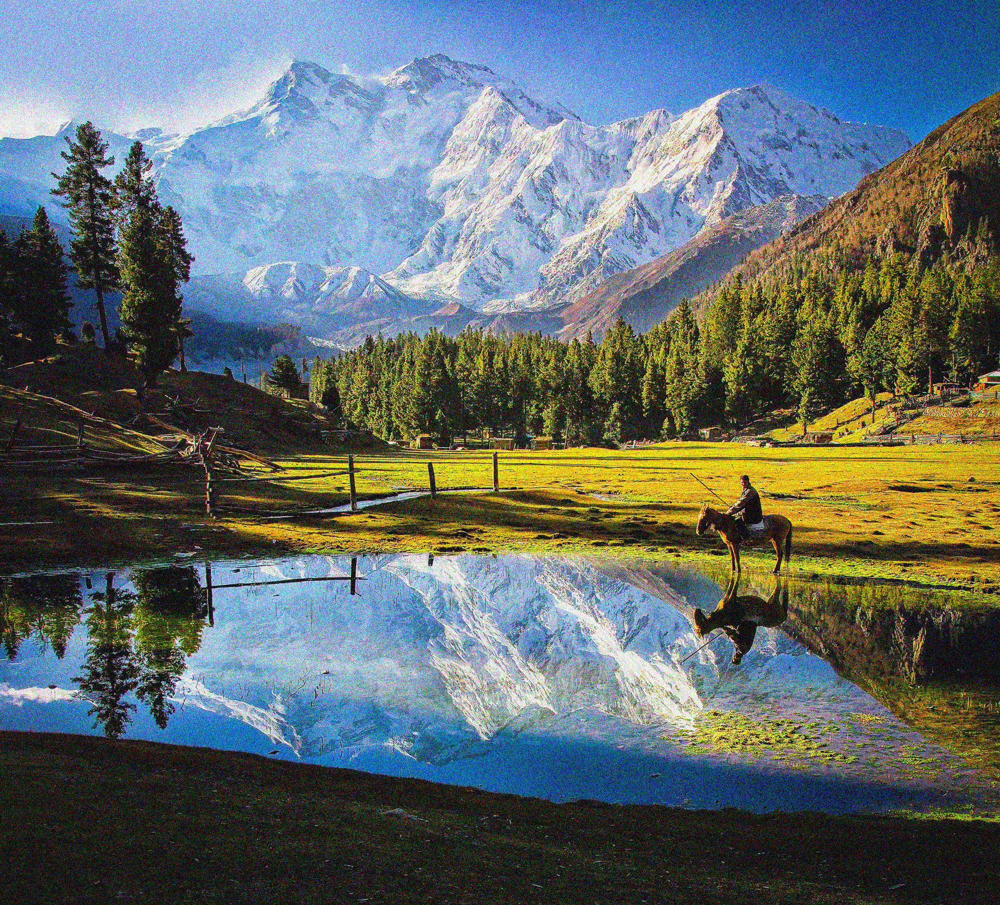

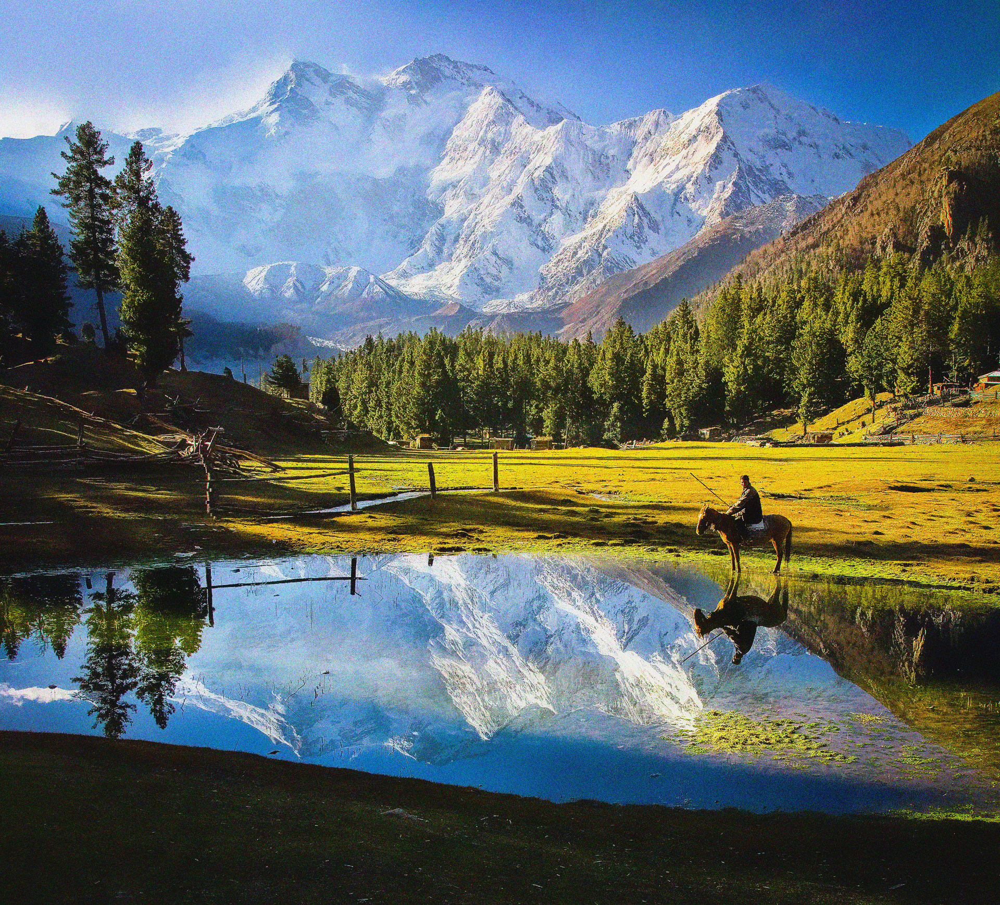

bilateral_1 29.482337699830747
bilateral_2 15.324223183923317


In [118]:
#bilateral_1 = cv2.bilateralFilter(noisy_imgs['rosso'], 10, 70, 5)
img_name = 'fairy-meadows'
img_dictionary = noisy_imgs
bilateral_2 = cv2.bilateralFilter(noisy_imgs[img_name], 50, 50, 80)
cv2_imshow(img_dictionary[img_name])
cv2_imshow(bilateral_2)

sigma_bilateral_1 = estimate_sigma(img_dictionary[img_name], multichannel=True, average_sigmas=True)
sigma_bilateral_2 = estimate_sigma(bilateral_2, multichannel=True, average_sigmas=True)

print('bilateral_1', sigma_bilateral_1)
print('bilateral_2', sigma_bilateral_2)

In [ ]:
bilateral_2 = cv2.bilateralFilter(noisy_imgs['rosso'], 30, 50, 5)
bilateral_2 = cv2.bilateralFilter(noisy_imgs['rosso'], 30, 60, 5)
bilateral_2 = cv2.bilateralFilter(noisy_imgs['rosso'], 30, 50, 15)
bilateral_2 = cv2.bilateralFilter(noisy_imgs['rosso'], 110, 50, 200)
bilateral_2 = cv2.bilateralFilter(noisy_imgs['rosso'], 110, 50, 80)
bilateral_2 = cv2.bilateralFilter(noisy_imgs[img_name], 110, 50, 80)
bilateral_2 = cv2.bilateralFilter(noisy_imgs[img_name], 50, 50, 80)

In [105]:
sigma_original = estimate_sigma(non_noisy_imgs['fairy-meadows'], multichannel=True, average_sigmas=True)
sigma_original

4.548745587238927

In [12]:
sigma_original = estimate_sigma(non_noisy_imgs['rosso'], multichannel=True, average_sigmas=True)
sigma_original

0.1853252773132074

Muito ruído tira os "detalhes" das regiões mais homogêneas

To think about - a variação no tamanho da janela só faz efeito quando o borramento é aplicado na imagem (quando ocorre aumento na1 variação na intensidade)?

Uma variação muito pequena das distâncias faz com que regiões homogêneas apresentem muito ruído

To think about - é possível compensar o aumento do tamanho da janela com o aumento da variação da intensidade e vice-versa?

Aumento no tamanho da janela - bordas mais definidas, mais ruído;
Aumento na variação da intensidade - maior borramento, menos ruído.


O tamanho da vizinhaça aumenta o ruído da imagem, aguçando as bordas

Maior variação das distâncias - melhor distribuição do ruído

Quanto menor a variação das distâncias, menos ele consegue distinguir as partes que devem ser borradas das que são bordas, isso é, menos consegue distinguir as regiões homogêneas das bordas

Para uma variação ótima de intensidade, o aumento da variação das distâncias tende a aguçar as bordas, dentro de um intervalo ótimo

Também existe um intervalo ótimo para o tamanho da vizinhança

Existe um intervalo ótimo para diminuir o ruído, que não é nem muito baixo nem muito alto

A partir de um certo valor, o aumento da variação das distâncias não causa mais efeito (o efeito é: quanto maior a variação, menos ruído)

O aumento do tamanho da vizinhança diminui a quanidade de ruído, em detrimento da performance - a um custo computacional muito alto

A variação das intensidades potencializa o efeito do borramento em detrimento do aguçamento das bordas

Quanto maior for a variação nas intensidades, mairo será o efeito do borramento

E o borramento **soberpõe qualquer outro fator**

Para o caso do aumento na variação das intensidade, a diminuição do ruído, não implica necessarimente na melhora da qualidade da imagem - a partir de um certo ponto a imagem começa a ficar muito borrada

Conclusão sobre o aumento da variação das intensidades: exite um valor máixmo para a o aumento da variação das intensidades, que deve ser definido empiricamente - pois o gráfico da variação do ruído na imagem **sempre** vai dimunir conforme a variação das intensidades aumente, mesmo quando a imagem está muito borrada

Apesar dessa potencialização do efeito do borramento quanto maior for a variação das intensidades, ela não terá tanto efeito para pequenas variações de distâncias

A variação das distâncias parece interferir no aguçamento das bordas